# Notebook 2 : étude de faisabilité avec les images

# 1. Imports et chargement des données

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from os import listdir
import time

from PIL import Image
from matplotlib.image import imread


#sklearn
from sklearn import preprocessing
from sklearn import cluster
from sklearn import manifold, decomposition
from sklearn import metrics

#SIFT
import cv2

#Keras
from keras.applications.vgg16 import VGG16
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import decode_predictions
from tensorflow.keras.models import Model

In [2]:
path = "Flipkart/Images/"
list_pictures = [file for file in listdir(path)]
print(len(list_pictures))

1050


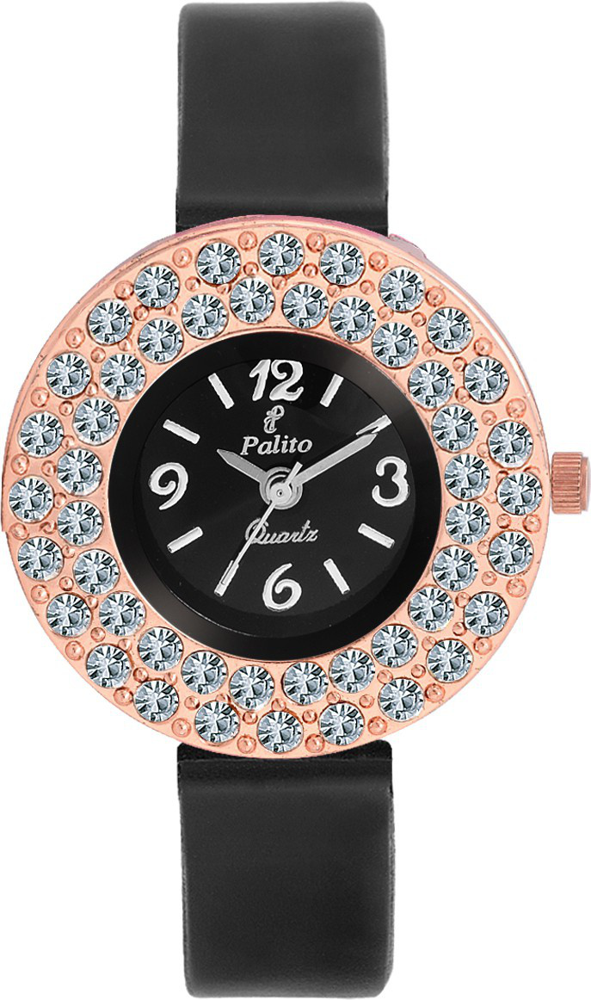

In [3]:
#Un exemple
img = Image.open(path + list_pictures[0])
img

In [4]:
df = pd.read_csv("for_notebook_2.csv")
df.head()

,image,target
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing


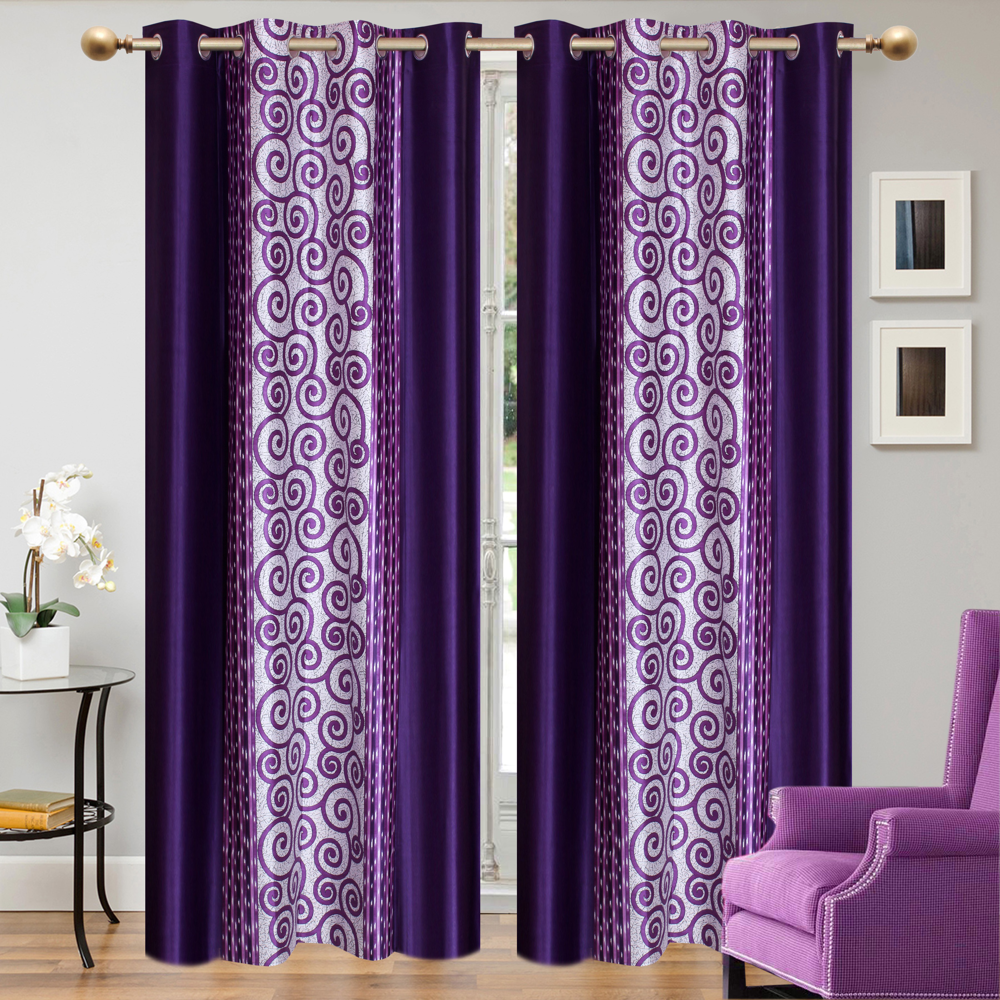

In [5]:
#Un test avec ceci aussi
img = Image.open(path + df["image"][0])
img

In [6]:
#J'encode la target
labelencoder = preprocessing.LabelEncoder()
df["label"] = labelencoder.fit_transform(df["target"])
df.head()

,image,target,label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,0
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,0
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,4
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,4


# 2. Affichage d'exemples par catégories

Je souhaite afficher, pour chaque catégorie, quelques exemples d'images.

Home Furnishing
-------


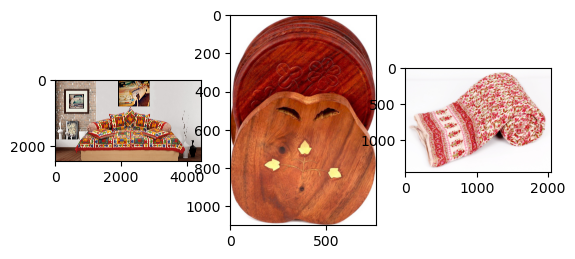

Baby Care
-------


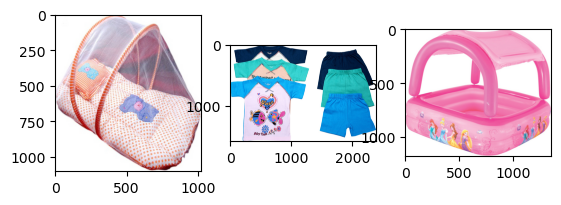

Watches
-------


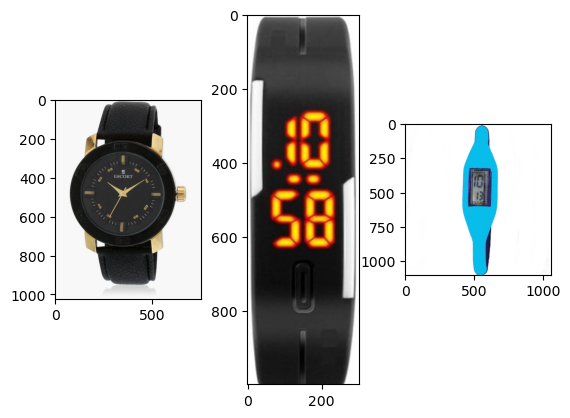

Home Decor & Festive Needs
-------


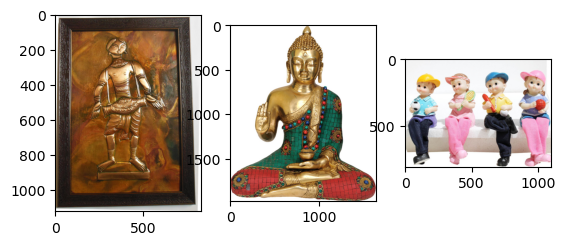

Kitchen & Dining
-------


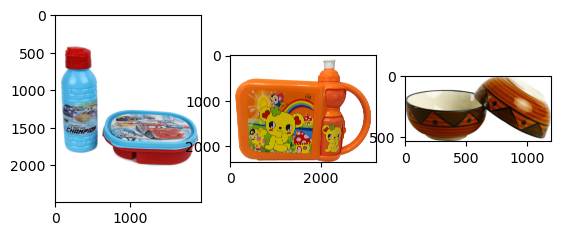

Beauty and Personal Care
-------


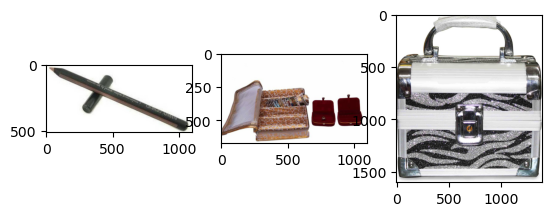

Computers
-------


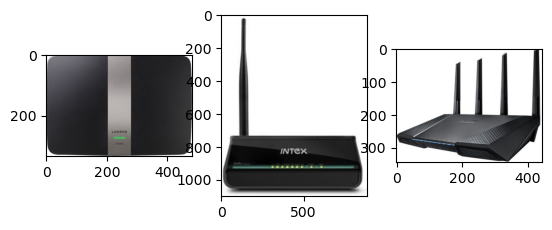

In [7]:
#Une première fonction qui me permet de séparer les images par catégories

def list_fct(name) :
    list_image_name = [df["image"][i] for i in range(len(df)) if df["target"][i]==name]
    return list_image_name

#Puis une boucle sur les catégories pour l'affichage.
for name in df["target"].unique() :
    print(name)
    print("-------")
    for i in range(3):
        plt.subplot(130 + 1 + i)
        filename = path + list_fct(name)[i+10]
        image = imread(filename)
        plt.imshow(image)
    plt.show()

# 3. Etude de faisabilité avec SIFT

## 3.1 Descripteurs SIFT

### 3.1.1 Pour une seule image

Je commence par tester sur une seule image. Essayons d'afficher les descripteurs.

(Disclaimer : Je ne joue pas avec les paramètres de SIFT car j'ai un fort espoir de faire mieux avec le modèle suivant dans tous les cas)

In [8]:
# Je récupère l'image
img = cv2.imread(path + df["image"][100])
# Je la convertis en niveaux de gris et j'aplatis l'histogramme
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img = cv2.equalizeHist(gray)

In [9]:
#Je récupère les descripteurs
sift = cv2.xfeatures2d.SIFT_create()

keypoints, descriptors = sift.detectAndCompute(img, None)

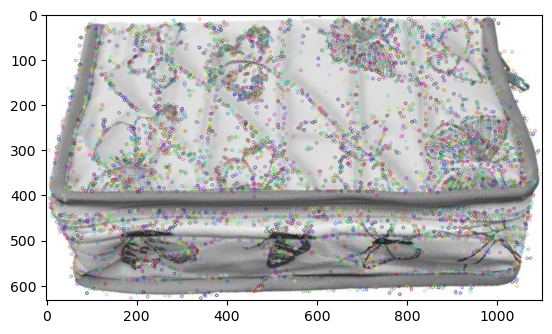

In [10]:
#Affichage :
img = cv2.drawKeypoints(gray, keypoints, img)

plt.imshow(img)
plt.show()

Chaque petit cercle coloré sur l'image correspond à un descripteur pour cette image. Dans cet exemple, ce sont les contours des papillons qui concentrent la majorité des descripteurs.

Est-ce que les autres objets de cette catégorie comprennent des papillons ? Rien n'est moins sûr.

Je peux aussi afficher le nombre de descripteurs retenus pour cette image :

In [11]:
descriptors.shape

(5452, 128)

5452 ! Cela fait vraiment beaucoup de descripteurs.

### 3.1.2 Pour toutes les images

In [12]:
sift_descriptors = []
t1=time.time()
sift = cv2.xfeatures2d.SIFT_create(500) #Je ne prends "que" 500 descripteurs par image

#Je procède comme pour l'image précédente, mais avec une boucle
for i in range(len(df["image"])):
    if i%100 == 0 : print(i) #Pour avoir l'avancement en temps réel
    image = cv2.imread(path+df["image"][i])
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    image = cv2.equalizeHist(gray)
    kp, des = sift.detectAndCompute(image, None)
    sift_descriptors.append(des)


timelapse = time.time() - t1
print("temps de traitement SIFT descriptor : ", "%15.2f" % timelapse , "secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de traitement SIFT descriptor :           251.82 secondes


In [13]:
sift_descriptors_all = np.concatenate(sift_descriptors, axis=0)

print("Nombre de descripteurs : ", sift_descriptors_all.shape)

Nombre de descripteurs :  (517306, 128)


La longueur devrait être 1050 * 500 = 502500, mais pour une raison que j'ignore, il a créé un peu plus de descripteurs pour les images (et de manière non homogène, ce qui est peu pratique). Mais bon, faisons avec. Je doute que cela impacte *trop* les résultats.

## 3.2 Cluster de descripteurs

Dans le but de créer des "mots de descripteurs", on effectue un clustering.

J'ai ouï-dire qu'un nombre de clusters approprié est approximé (en ordre de grandeur) par la racine carrée de mon nombre de descripteurs.

In [14]:
k = int(round(np.sqrt(len(sift_descriptors_all)),0))
print("Nombre de clusters estimés : ", k)

Nombre de clusters estimés :  719


In [15]:
t1=time.time()

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(sift_descriptors_all)

duration1=time.time()-t1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

temps de traitement kmeans :             7.39 secondes


## 3.3 "Bag-of-features"

Sur le même concept que le bag-of-words, on va considérer chaque image comme une phrase, et chaque cluster de descripteurs comme un mot. On va ensuite effectuer un comptage pour décrire chaque image par un histogramme.

In [16]:
hist_vectors = []
for image_desc in sift_descriptors:
    words = kmeans.predict(image_desc)
    
    hist = np.zeros(k)
    for i in words:
        hist[i] += 1.0/len(image_desc)
    
    hist_vectors.append(hist)
    


In [17]:
np.asarray(hist_vectors).shape

(1050, 719)

In [18]:
image_features = np.asarray(hist_vectors)

## 3.4 Réduction de dimension (PCA, T-SNE)

On commence par une PCA pour gagner en temps de travail sur le T-SNE.

In [19]:
print("Dimensions dataset avant réduction PCA : ", image_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca= pca.fit_transform(image_features)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 719)
Dimensions dataset après réduction PCA :  (1050, 499)


En conservant 99% de la variance expliquée, on élimine tout de même un nombre conséquent de dimensions.

In [20]:
tsne = manifold.TSNE(n_components=2, perplexity=30, 
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca)

C:\Users\Yann\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


## 3.5 Analyse visuelle

Je reprends mon code du premier notebook pour l'affichage.

In [21]:
def compare_with_tsne(X_tsne, df):
    """
    This is the same function as 'test vectorizer' from the first notebook, 
    except it starts after T-SNE projection
    """
    
    # Then, we train the K-Means algorithm
    cls = cluster.KMeans(n_clusters = 7)
    cls.fit(X_tsne)
    
    #On construit le dataframe pour la visualisation
    df_tsne = pd.DataFrame(X_tsne, columns=['tsne1', 'tsne2'])
    df_tsne["class"] = cls.labels_
    df_tsne["target"] = df["target"]
    
    #Pour le tracé :
    fig, axis = plt.subplots(2,1, figsize = (20,24),layout="constrained")
    plt.subplot(211)
    sns.scatterplot(
        x="tsne1", y="tsne2",
        hue="class",
        palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6,
        data=df_tsne,
        legend="brief")
    
    plt.gca().set_title('TSNE selon les prédictions', fontsize = 30, pad = 35, fontweight = 'bold')
    plt.legend(prop={'size': 18})
    
    plt.subplot(212)
    sns.scatterplot(
        x="tsne1", y="tsne2",
        hue="target",
        palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6,
        data=df_tsne,
        legend="brief",
        ax = axis[1])
    
    plt.gca().set_title('TSNE selon la target réelle', fontsize = 30, pad = 35, fontweight = 'bold')
    plt.legend(prop={'size': 18})
    
    plt.show()
    
    #Pour le score ARI :
    ARI = metrics.adjusted_rand_score(df["target"], cls.labels_)
    print(f"score ARI {ARI}")
    
    return cls

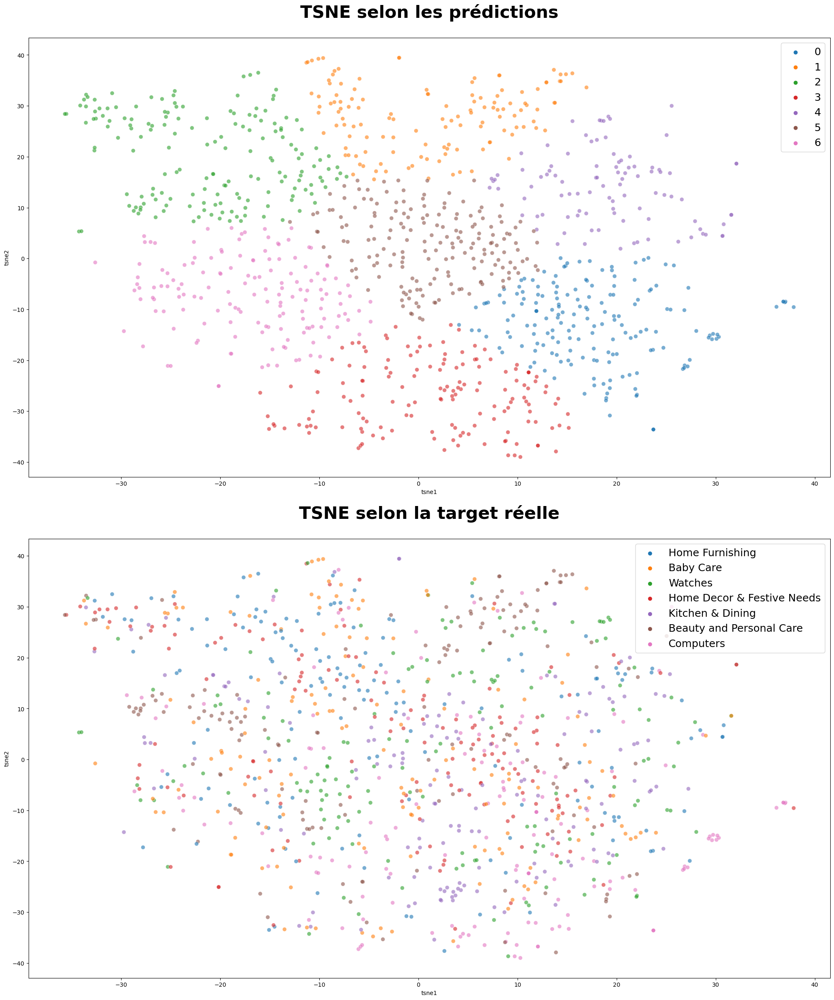

score ARI 0.032719365252927665


In [22]:
cls = compare_with_tsne(X_tsne, df)

Les résultats sont absolument désastreux.

Aucune classe n'est prédite correctement.

Je m'épargne la matrice de confusion ici. Essayons le Transfer Learning :

# 4. Transfer Learning

Si notre modèle précédent donne des résultats si mauvais, c'est probablement parce que :

- Je n'ai pas beaucoup de données (1050 images)

- Elles ne se ressemblent pas du tout. Il suffit de voir la partie 2 de ce notebook. Les objets sont de la même catégorie, mais ils ne se ressemblent pas.

Essayons donc avec un autre modèle, pré-entraîné sur une banque d'images bien plus importante.

## 4.1 Catégories prédites par VGG16

In [23]:
model = VGG16()

In [24]:
predictions = []
for i in range(len(df["image"])):
    #VGG16 ne prend que des images de taille 224x224
    img = load_img(path + df["image"][i], target_size = (224,224))
    img = img_to_array(img)
    img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))
    img = preprocess_input(img)
    predictions.append(decode_predictions(model.predict(img)))
    
df["predicted_by_VGG16"] = predictions

1/1 [==============================] - 0s 102ms/step


1/1 [==============================] - 0s 98ms/step


1/1 [==============================] - 0s 98ms/step


C:\Users\Yann\anaconda3\lib\site-packages\PIL\Image.py:3035: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 [==============================] - 0s 100ms/step


1/1 [==============================] - 0s 108ms/step


In [25]:
df["predicted_by_VGG16"].value_counts()

[[(n04579432, whistle, 0.3503445), (n04041544, radio, 0.21546237), (n04372370, switch, 0.08821214), (n03692522, loupe, 0.07821613), (n03759954, microphone, 0.05463913)]]                       7
[[(n04041544, radio, 0.28634852), (n03196217, digital_clock, 0.09404254), (n03777754, modem, 0.04462758), (n03485407, hand-held_computer, 0.038784634), (n04286575, spotlight, 0.03333522)]]    4
[[(n03255030, dumbbell, 0.19579387), (n04579432, whistle, 0.16306324), (n03483316, hand_blower, 0.116394095), (n02951585, can_opener, 0.113970645), (n03970156, plunger, 0.06381995)]]          3
[[(n03777754, modem, 0.32925946), (n03666591, lighter, 0.1770024), (n04041544, radio, 0.10510735), (n03492542, hard_disc, 0.055412885), (n03832673, notebook, 0.04232852)]]                     3
[[(n04372370, switch, 0.1870616), (n03255030, dumbbell, 0.16220404), (n03075370, combination_lock, 0.13339868), (n02951585, can_opener, 0.11098179), (n04579432, whistle, 0.047477525)]]        3
                              

Le modèle VGG16 ayant été entraîné sur un autre jeu de données, il a appris à déterminer 1000 classes, mais pas les notres. Il va donc falloir opérer un fine-tuning partiel, consistant à réentraîner uniquement les dernières couches de celui-ci.

## 4.2 Extraction des features

In [26]:
#Je supprime uniquement la dernière couche de VGG16
new_model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

new_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [27]:
#Pour référence, voici le "summary" du VGG16 de base, avec une dernière couche en plus.
model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [28]:
#Je créé alors mes features avec ce modèle 
images_features = []
i = 0
for code in df["image"]:
    if i%100 == 0:
        print(i)
    i += 1
    image = load_img(path + code, target_size=(224, 224))
    image = img_to_array(image) 
    image = np.expand_dims(image, axis=0)
    image = preprocess_input(image)
    images_features.append(new_model.predict(image, verbose=0)[0]) # predict from pretrained model

0
100
200
300
400
500
600


C:\Users\Yann\anaconda3\lib\site-packages\PIL\Image.py:3035: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


700
800
900
1000


In [29]:
images_features = np.asarray(images_features)
images_features.shape #Exporter ça ou non ??

(1050, 4096)

## 4.3 Réduction de dimension

Comme pour SIFT, on va d'abord utiliser une PCA avant le T-SNE, pour gagner du temps (au détriment de 1% de variance expliquée).

In [30]:
print(images_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca= pca.fit_transform(images_features)
print(feat_pca.shape)

(1050, 4096)
(1050, 803)


On a une bonne division par 5 du nombre de dimensions

In [31]:
t1 = time.time()

tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca)

duration1=time.time()-t1
print("temps de T-SNE : ", "%15.2f" % duration1, "secondes")

C:\Users\Yann\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


temps de T-SNE :             9.54 secondes


## 4.4 Analyse visuelle

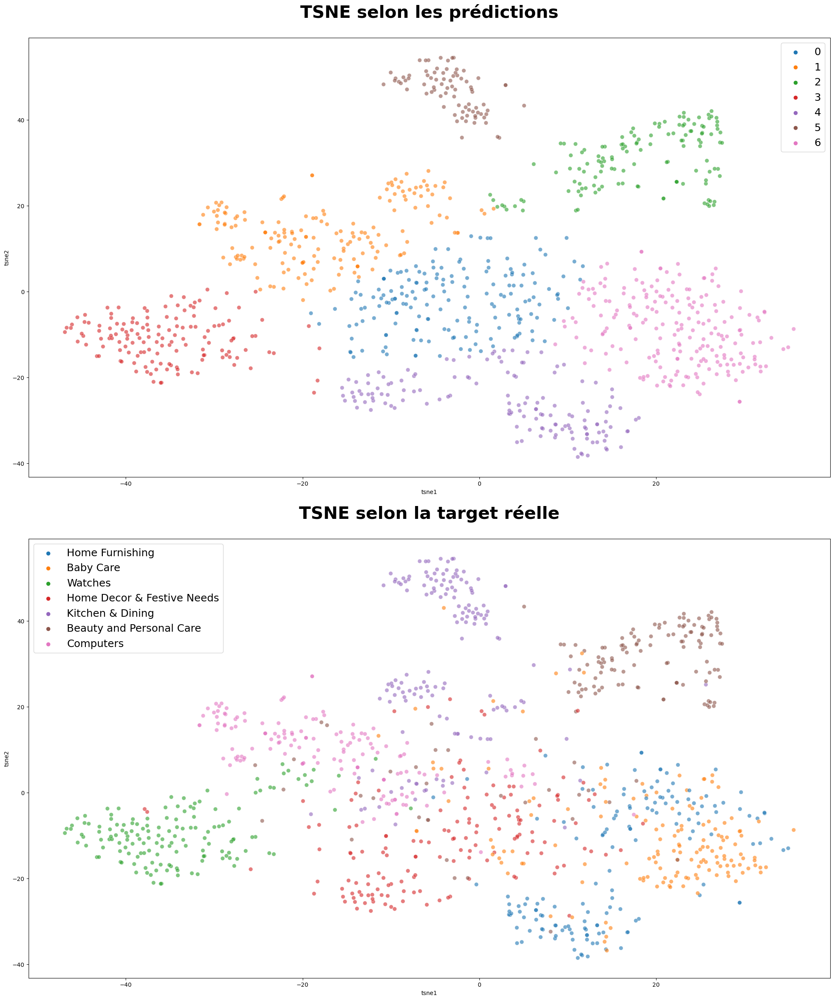

score ARI 0.4433182704801222


In [32]:
cls = compare_with_tsne(X_tsne, df)

Cela est beaucoup plus prometteur.

Certaines catégories sont bien identifiées : Watches, Beauty & Personal Care.

D'autres le sont partiellement : Kitchen & Dining, Computers, Home Decor, Baby Care.

La catégorie "Home Furnishing" est la seule très mal identifiée.

Essayons d'observer une matrice de confusion pour mettre des chiffres sur ces impressions visuelles.

## 4.5 Matrice de confusion

In [33]:
conf_mat = metrics.confusion_matrix(df["label"], cls.labels_)
conf_mat

array([[ 13,   2,   5,   0,  16,   1, 113],
       [ 16,   6, 116,   1,   4,   1,   6],
       [ 39, 109,   0,   1,   0,   0,   1],
       [ 73,   6,   1,   7,  54,   0,   9],
       [  5,   0,   0,   0,  68,   0,  77],
       [ 24,  36,  11,   0,   0,  78,   1],
       [  2,  14,   0, 134,   0,   0,   0]], dtype=int64)

In [34]:
def conf_mat_transform(y_true,y_pred) :
    """
    met la matrice de confusion "dans l'ordre" (avec la diagonale dominante)
    """
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    corresp = np.argmax(conf_mat, axis=0)
    print ("Correspondance des clusters : ", corresp)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

In [35]:
cls_labels_transform = conf_mat_transform(df["label"], cls.labels_)
conf_mat = metrics.confusion_matrix(df["label"], cls_labels_transform)
conf_mat

Correspondance des clusters :  [3 2 1 6 4 5 0]


array([[113,   5,   2,  13,  16,   1,   0],
       [  6, 116,   6,  16,   4,   1,   1],
       [  1,   0, 109,  39,   0,   0,   1],
       [  9,   1,   6,  73,  54,   0,   7],
       [ 77,   0,   0,   5,  68,   0,   0],
       [  1,  11,  36,  24,   0,  78,   0],
       [  0,   0,  14,   2,   0,   0, 134]], dtype=int64)

<AxesSubplot:>

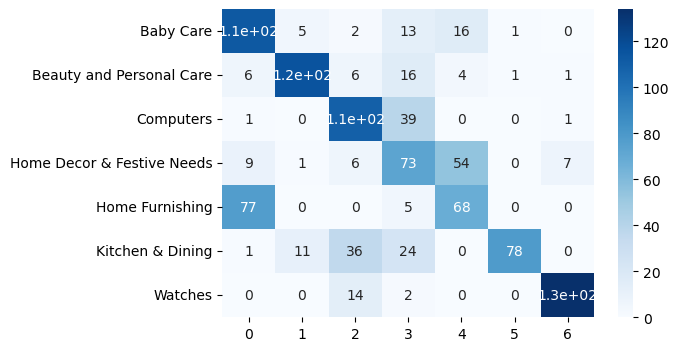

In [36]:
#Je renomme les lignes de ma matrice de confusion pour l'interprétation. Pour cela, j'associe les catégories 
#dans l'ordre de labélisation
list_labels = ["Baby Care","Beauty and Personal Care","Computers","Home Decor & Festive Needs","Home Furnishing","Kitchen & Dining","Watches"]

df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")

Pour conclure, cette matrice nous informe, par exemple, que :

- Les catégories "Beauty..." et "Watches" sont trouvées avec une précision très forte.
- Lorsque le modèle prédit "Baby Care", il se trompe rarement. Cependant, lorsque la catégorie réelle est "Baby Care", il pense souvent que la classe est "Home Furnishing".

- à l'inverse, la catégorie "Home Furnishing" est mal prédite (moins de 50% de précision), mais elle n'est confondue (presque) qu'avec la catégorie "Baby Care".
- On observe un phénomène similaire au point précédent avec "Home Decor & Festive Needs", souvent confondue avec "Home Furnishing" par le modèle.


- Pour la catégorie "Computers", c'est un peu un mélange de toutes les situations. Le modèle le confond parfois (environ 30% du temps) avec "Kitchen..." ou "Watches" mais est précis le reste du temps, et il ne prédit aucun "non-computer" en tant que "computer", sauf pour la classe "Home Decor..." pour laquelle il se trompe très souvent !

Globalement, cela nous donne une information un peu plus précise de "comment" notre modèle se trompe. C'est plus parlant que le "flou" du nuage de points au milieu de notre T-SNE de tout à l'heure.

# 5 . Conclusion

Par rapport aux analyses textuelles, le résultat ici est bien plus probant. (Augmentation d'environ 50% du meilleur score ARI)
On ressent également, et encore mieux que pour le texte, que certaines classes seront plutôt faciles à prédire. En revanche, on n'est pas encore tout à fait satisfaits, car notre meilleur score ARI reste encore inférieur à 0.5, ce qui est intrésèquement pas terrible.

J'ai tout de même envie d'être optimiste, en voyant que certaines classes sont déjà très bien prédites, et que d'autres n'en sont pas si loin. J'aimerais dire que mon étude de faisabilité est plutôt prometteuse, et que j'aimerais maintenant essayer l'apprentissage supervisé.